<a href="https://colab.research.google.com/github/Ishwarprajapati318/image-segmentation-/blob/main/Image_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

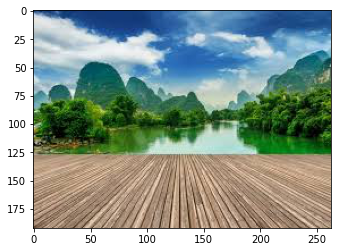

In [ ]:
from skimage.color import rgb2gray
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline
from scipy import ndimage

image = plt.imread('1.jpeg')
image.shape
plt.imshow(image)

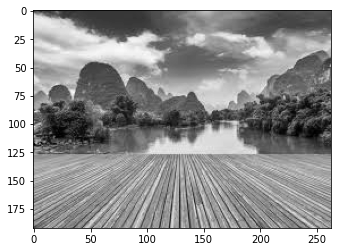

In [ ]:
image = plt.imread('1.jpeg')
image.shape
gray = rgb2gray(image)
plt.imshow(gray, cmap='gray')

In [ ]:
gray.shape


(192, 263)

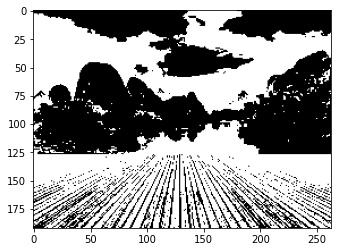

In [ ]:
gray_r = gray.reshape(gray.shape[0]*gray.shape[1])
for i in range(gray_r.shape[0]):
    if gray_r[i] > gray_r.mean():
        gray_r[i] = 1
    else:
        gray_r[i] = 0
gray = gray_r.reshape(gray.shape[0],gray.shape[1])
plt.imshow(gray, cmap='gray')

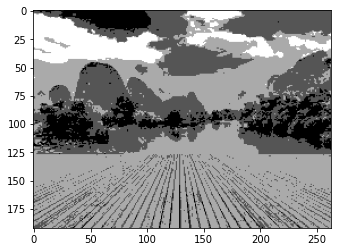

In [ ]:
gray = rgb2gray(image)
gray_r = gray.reshape(gray.shape[0]*gray.shape[1])
for i in range(gray_r.shape[0]):
    if gray_r[i] > gray_r.mean():
        gray_r[i] = 3
    elif gray_r[i] > 0.5:
        gray_r[i] = 2
    elif gray_r[i] > 0.25:
        gray_r[i] = 1
    else:
        gray_r[i] = 0
gray = gray_r.reshape(gray.shape[0],gray.shape[1])
plt.imshow(gray, cmap='gray')

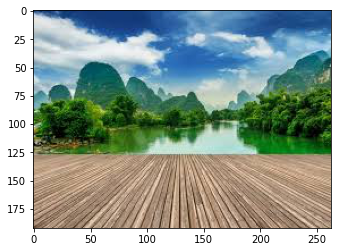

In [ ]:
image = plt.imread('1.jpeg')
plt.imshow(image)

In [ ]:
# converting to grayscale
gray = rgb2gray(image)

# defining the sobel filters
sobel_horizontal = np.array([np.array([1, 2, 1]), np.array([0, 0, 0]), np.array([-1, -2, -1])])
print(sobel_horizontal, 'is a kernel for detecting horizontal edges')
 
sobel_vertical = np.array([np.array([-1, 0, 1]), np.array([-2, 0, 2]), np.array([-1, 0, 1])])
print(sobel_vertical, 'is a kernel for detecting vertical edges')

[[ 1  2  1]
 [ 0  0  0]
 [-1 -2 -1]] is a kernel for detecting horizontal edges
[[-1  0  1]
 [-2  0  2]
 [-1  0  1]] is a kernel for detecting vertical edges


In [ ]:

out_h = ndimage.convolve(gray, sobel_horizontal, mode='reflect')
out_v = ndimage.convolve(gray, sobel_vertical, mode='reflect')
# here mode determines how the input array is extended when the filter overlaps a border.

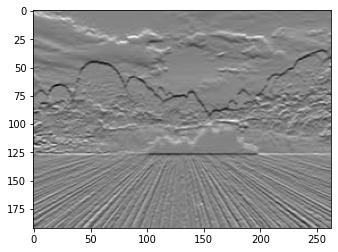

In [ ]:
plt.imshow(out_h, cmap='gray')

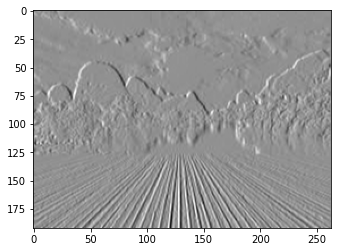

In [ ]:
plt.imshow(out_v, cmap='gray')

In [ ]:
kernel_laplace = np.array([np.array([1, 1, 1]), np.array([1, -8, 1]), np.array([1, 1, 1])])
print(kernel_laplace, 'is a laplacian kernel')

[[ 1  1  1]
 [ 1 -8  1]
 [ 1  1  1]] is a laplacian kernel


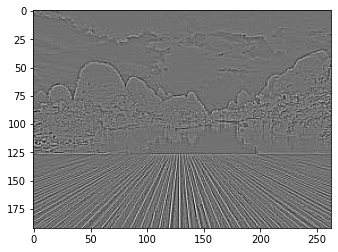

In [ ]:
out_l = ndimage.convolve(gray, kernel_laplace, mode='reflect')
plt.imshow(out_l, cmap='gray')

(192, 263, 3)


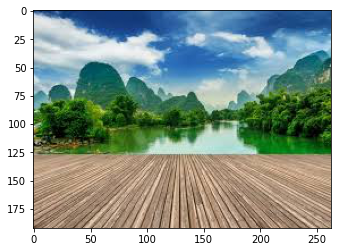

In [ ]:
pic = plt.imread('1.jpeg')/255  # dividing by 255 to bring the pixel values between 0 and 1
print(pic.shape)
plt.imshow(pic)

In [ ]:
pic_n = pic.reshape(pic.shape[0]*pic.shape[1], pic.shape[2])
pic_n.shape

(50496, 3)

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=5, random_state=0).fit(pic_n)
pic2show = kmeans.cluster_centers_[kmeans.labels_]

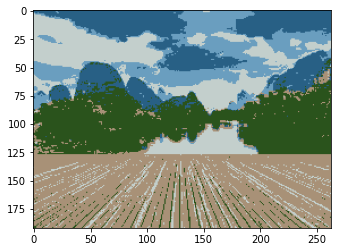

In [ ]:
cluster_pic = pic2show.reshape(pic.shape[0], pic.shape[1], pic.shape[2])
plt.imshow(cluster_pic)

In [86]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from sklearn.mixture import GaussianMixture as GMM






[[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 ...

 [[208 200 200]
  [208 200 200]
  [208 200 200]
  ...
  [197 203 208]
  [197 203 208]
  [197 203 208]]

 [[208 200 200]
  [208 200 200]
  [208 200 200]
  ...
  [197 203 208]
  [197 203 208]
  [197 203 208]]

 [[208 200 200]
  [208 200 200]
  [208 200 200]
  ...
  [197 203 208]
  [197 203 208]
  [197 203 208]]]
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[213 201 201]
  [212 200 200]
  [212 200 200]
  ..

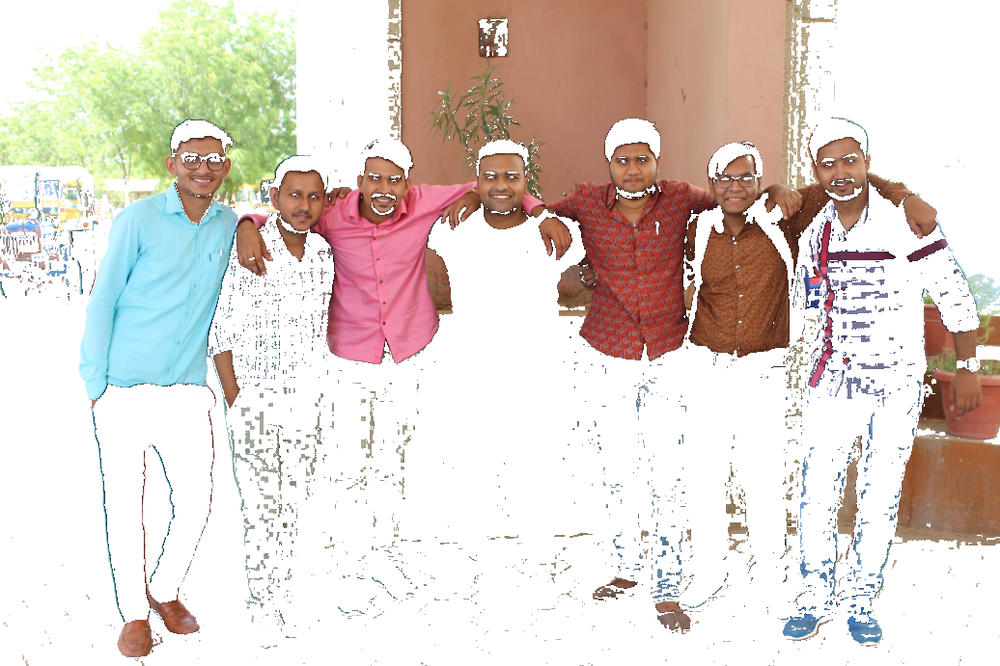

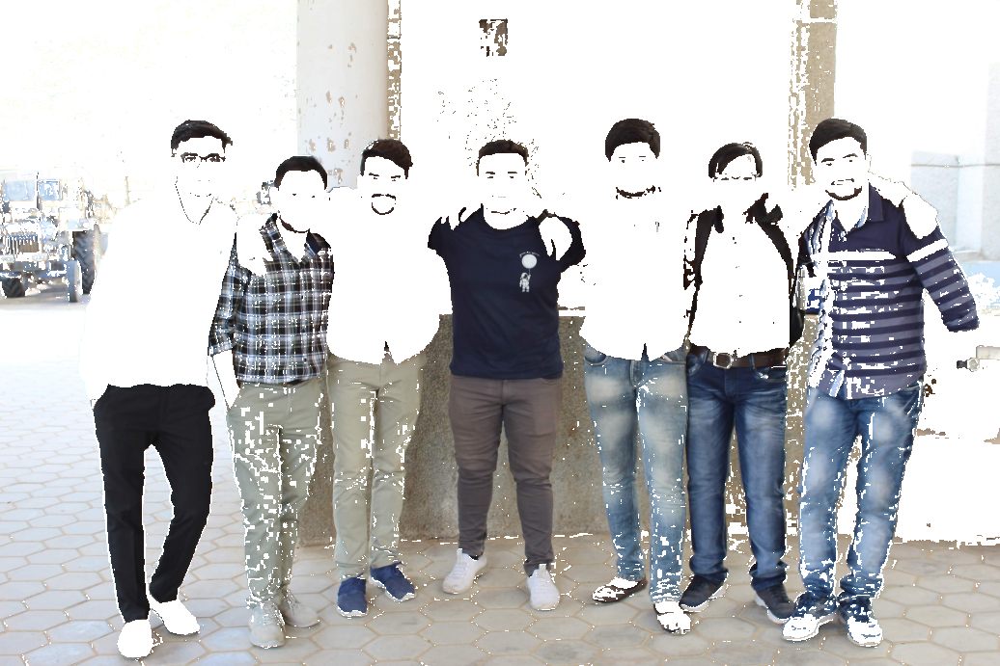

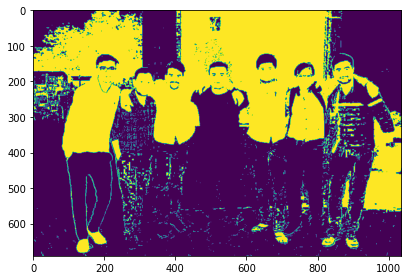

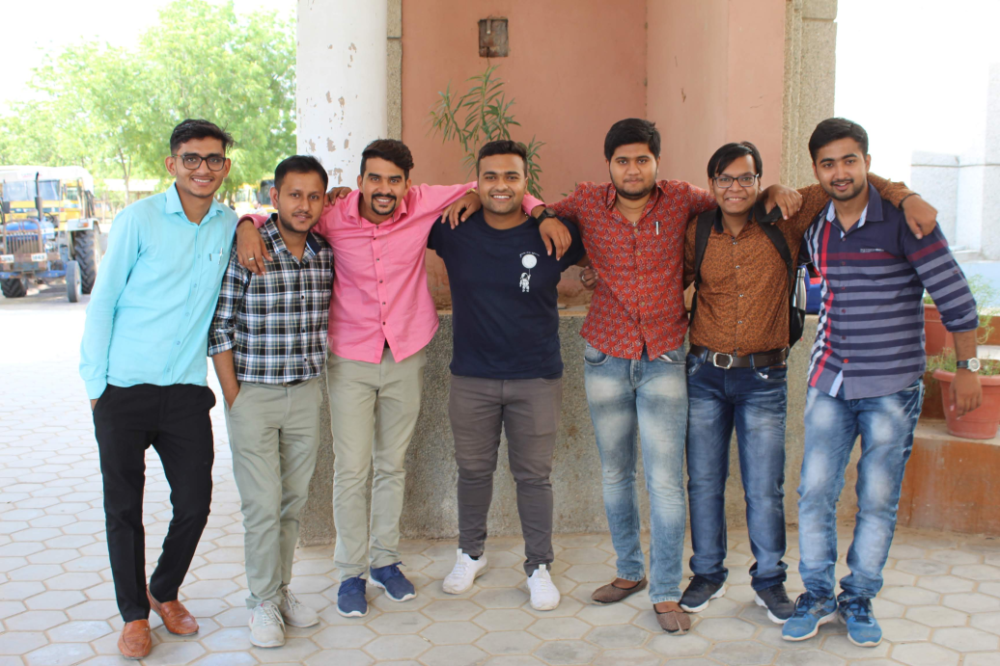

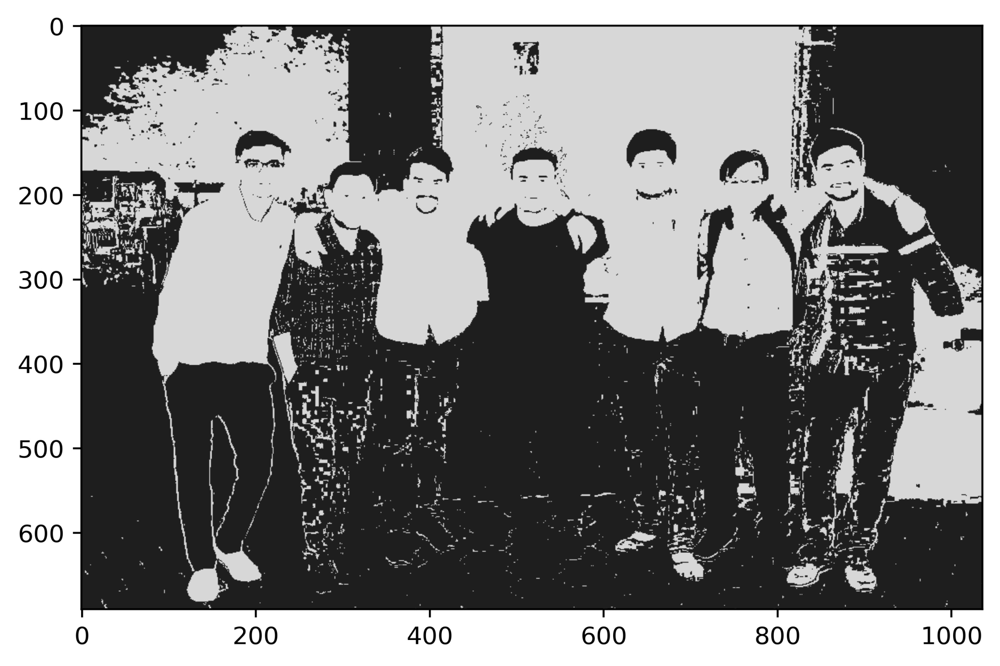

In [79]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Mon Nov 22 23:35:44 2021

@author: deltaplus
"""

#imports
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture as GMM


def resize_image(img,Scale):
    """Reshape the image to the scale of the image"""
    #new width
    width = int(data_img.shape[1] * Scale/ 100)
    
    #new height
    height = int(data_img.shape[0] * Scale/ 100)
    
    #new dimension
    dimension = (width, height)   
    
    # return resized new image
    return cv2.resize(img, dimension, interpolation = cv2.INTER_AREA)

#variables
Name = "frd"
File_Name = Name+".jpg"
Result_Name = Name+"-Segmented.jpg"


#import image
data_img = cv2.imread("IMG_2976.JPG",cv2.IMREAD_COLOR)

print(data_img)
#resized image
new_img = resize_image(data_img, 30)
assert not isinstance(new_img,type(None)), 'new_img not found'

print(new_img)



#image resize to lower-dimension for segentation
res_image = new_img.reshape((-1,3))


#implement the model
#coavriance_type can be used a.tied, b.full, c.diag, d. spherical
n_comp = 2
seg_model = GMM(n_components=n_comp,covariance_type="full")

#fit the  resahped image
seg_model.fit(res_image)

#prdicted labels of gmm
seg_labels = seg_model.predict(res_image)
print(seg_labels.shape)

seg_temp = seg_labels

#size of the image
Shape = new_img.shape
print("Shape of the resized image : ",Shape)

image_segmented = seg_labels.reshape(Shape[0],Shape[1])


#copy resize image
for i in range(n_comp):
    temp = res_image.copy()
    for j in range(len(seg_temp)):
        
        if(seg_temp[j]==i):
            temp[j] = np.array([255,255,255]) 
    temp = np.reshape(temp,(Shape[0],Shape[1],3))
    img=cv2_imshow(temp)
    # cv2_imshow(img)
    cv2.imwrite(Name+str(i)+".jpg",temp)

#plot
plt.imshow(image_segmented)



#save file
plt.tight_layout()
plt.savefig(Result_Name,dpi = 500, bbox_inches = 'tight')
plt.show()


#read stored file
Data = cv2.imread(Result_Name,0)
Data = resize_image(Data,60)

# show image
cv2_imshow(new_img)
cv2_imshow(Data)
cv2.waitKey(0)
cv2.destroyAllWindows()






[[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 ...

 [[208 200 200]
  [208 200 200]
  [208 200 200]
  ...
  [197 203 208]
  [197 203 208]
  [197 203 208]]

 [[208 200 200]
  [208 200 200]
  [208 200 200]
  ...
  [197 203 208]
  [197 203 208]
  [197 203 208]]

 [[208 200 200]
  [208 200 200]
  [208 200 200]
  ...
  [197 203 208]
  [197 203 208]
  [197 203 208]]]
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 ...

 [[209 200 200]
  [209 200 200]
  [209 200 200]
  ..

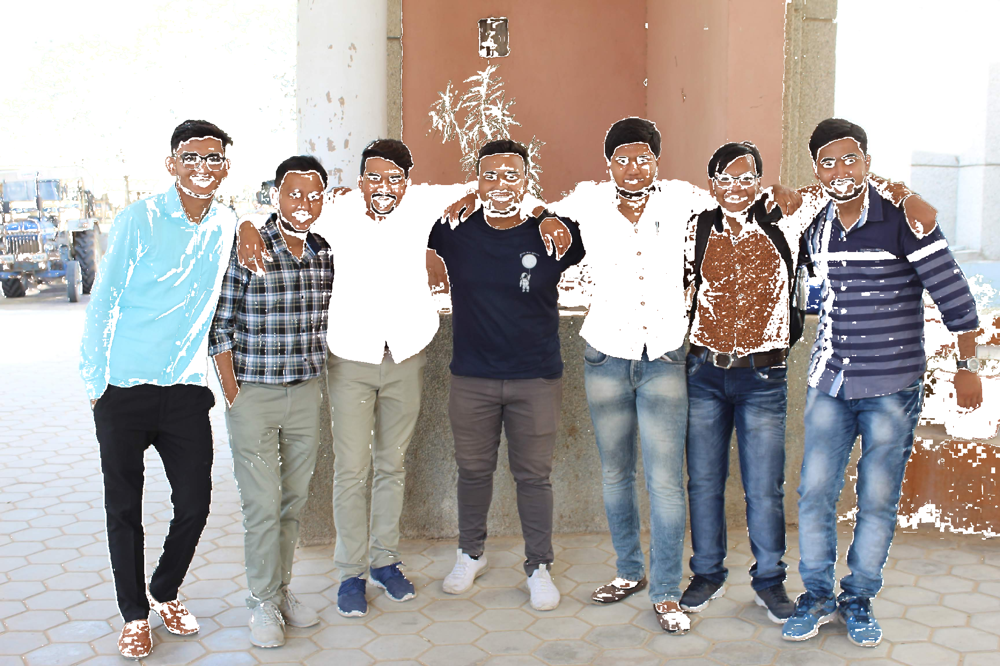

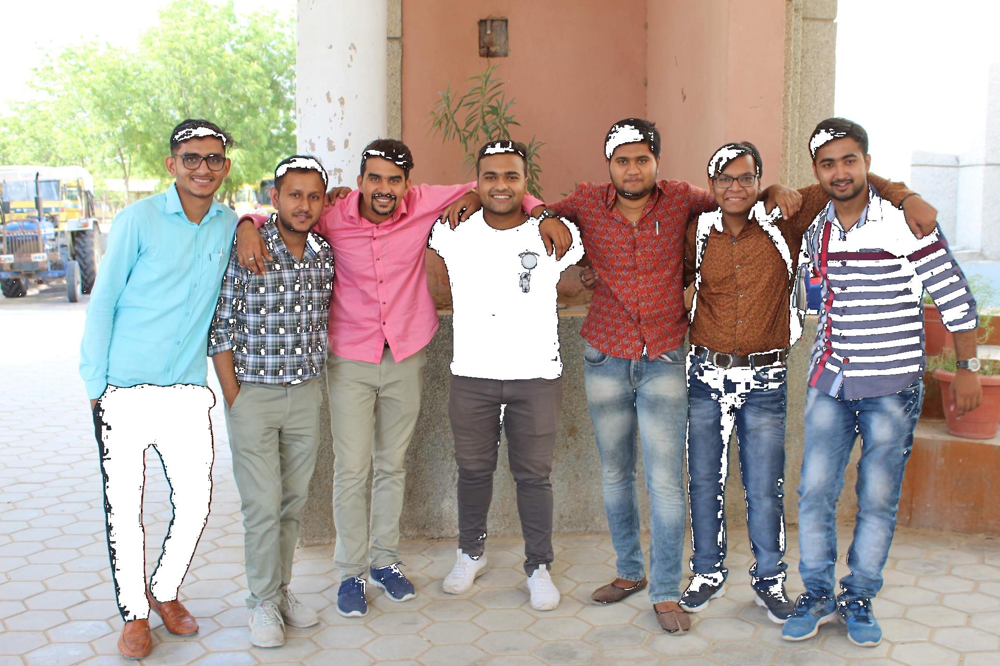

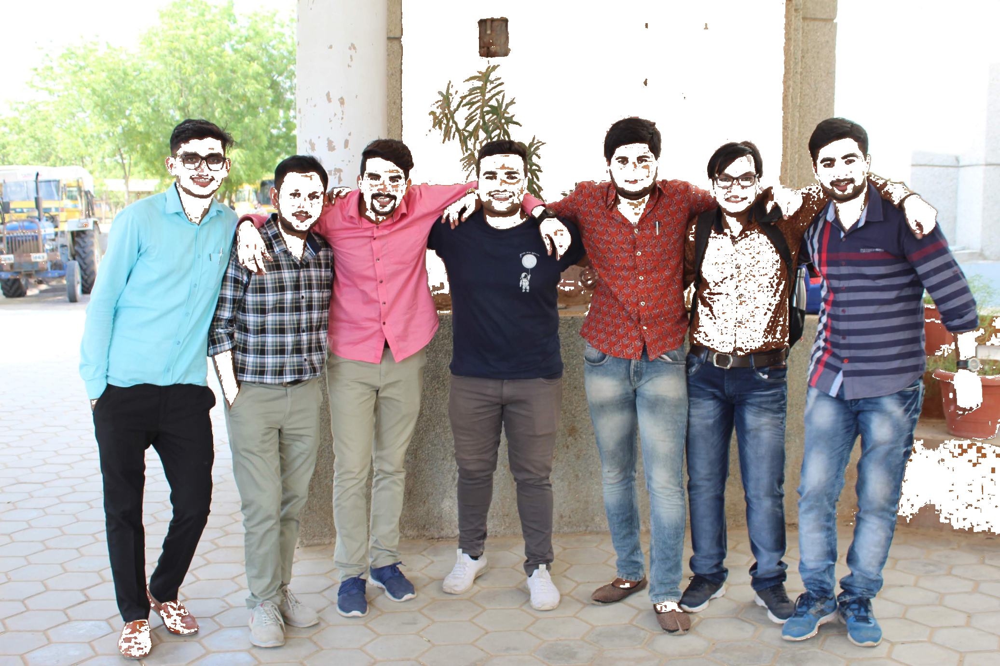

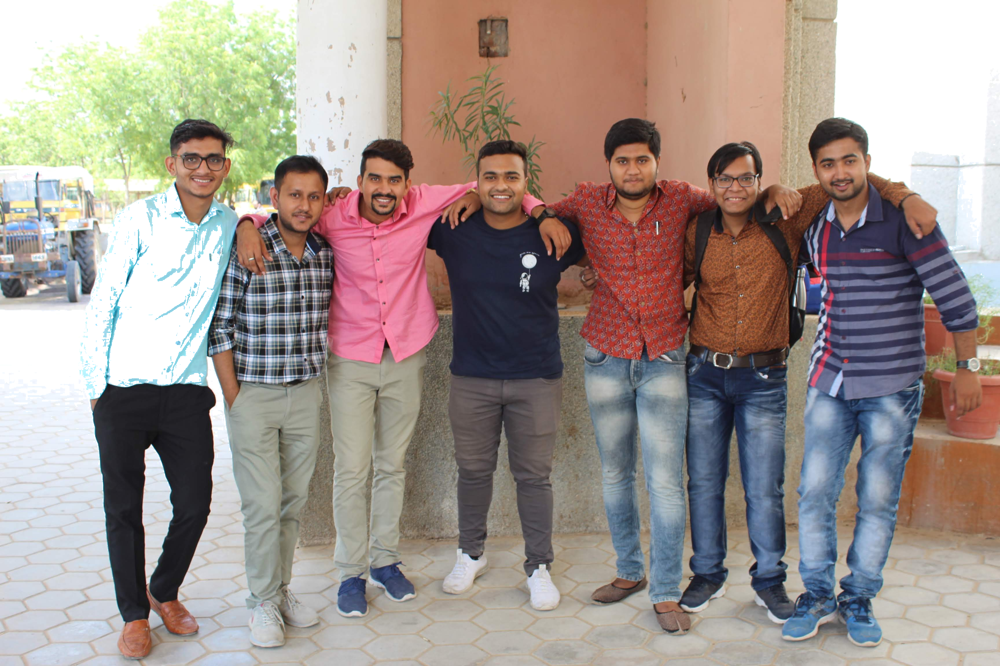

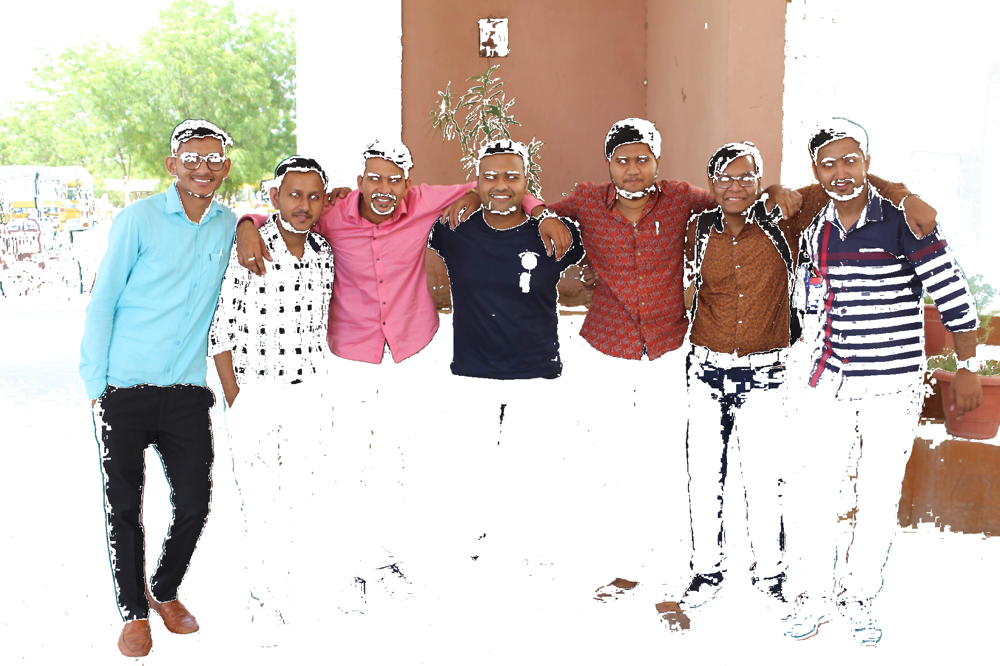

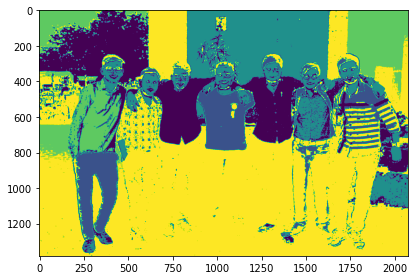

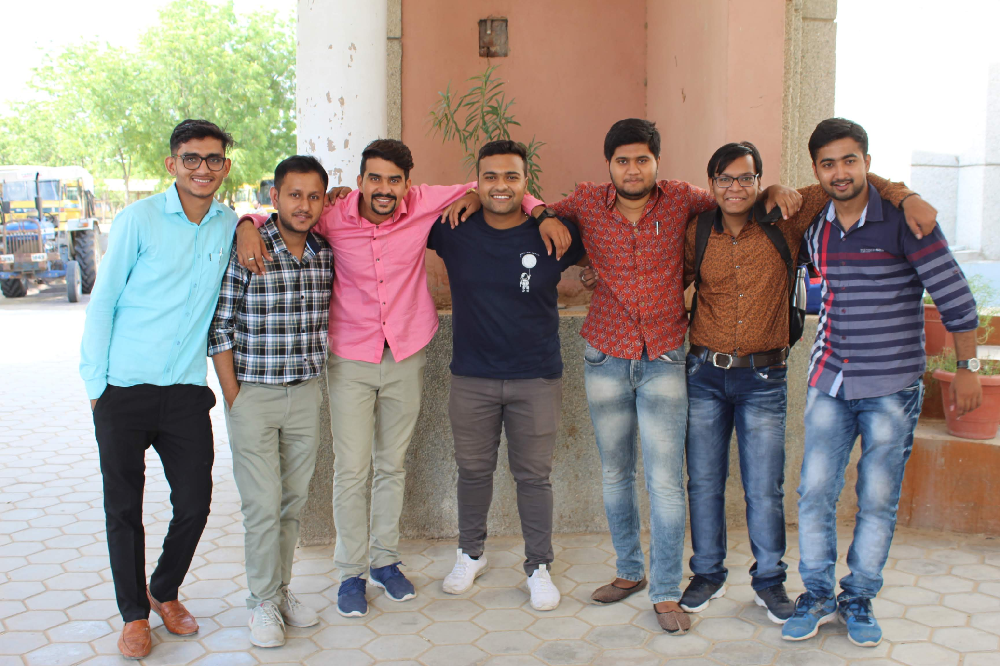

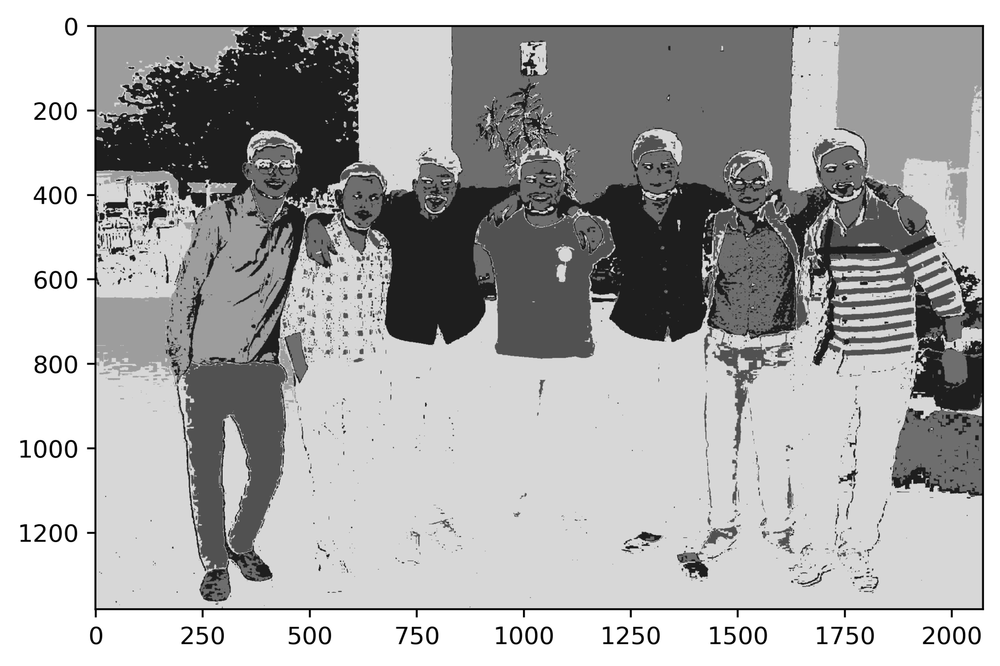

In [81]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Mon Nov 22 23:35:44 2021

@author: deltaplus
"""
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture as GMM


def resize_img(img,Scale):
    """Reshape the image to the scale of the image"""
    #new width of blood cell image
    new_width = int(data_img.shape[1] * Scale/ 100)
    
    #new height of blood cell image
    new_height = int(data_img.shape[0] * Scale/ 100)
    
    #new dimension for blood cell image
    new_dimension = (new_width, new_height)   
    
    # return resized new image
    return cv2.resize(img, new_dimension, interpolation = cv2.INTER_AREA)

#variables name for image result
Img_Name = "frds"
Result_Img_Name = Img_Name+"-Segmented.jpg"


#image import from colab files
new_data_img = cv2.imread("IMG_2976.JPG",cv2.IMREAD_COLOR)

print(new_data_img)
#resized new_data_img
new_image = resize_img(new_data_img, 60)
assert not isinstance(new_image,type(None)), 'new_image not found'
print(new_image)


#new_image is resize to lower dimension segentation purpose
res_new_image = new_image.reshape((-1,3))


#implement GMM model
#coavriance_type can be used a.tied, b.full, c.diag, d. spherical
alpha = 5
segmentation_model = GMM(n_components=alpha,covariance_type="full")

#fit the  resahped image to segmentation model
segmentation_model.fit(res_new_image)

#prdicted labels of gmm on img
segmentation_labels = segmentation_model.predict(res_new_image)
print(segmentation_labels.shape)

segmentation_beta = segmentation_labels

#size of the imge
New_Shape = new_image.shape
print("Shape of the resized image : ",New_Shape)

img_segmented = segmentation_labels.reshape(New_Shape[0],New_Shape[1])


#copy resized imge 
for i in range(alpha):
    beta = res_new_image.copy()
    for j in range(len(segmentation_beta)):
        
        if(segmentation_beta[j]==i):
            beta[j] = np.array([255,255,255]) 
    beta = np.reshape(beta,(New_Shape[0],New_Shape[1],3))
    img=cv2_imshow(beta)
    # cv2_imshow(img)
    cv2.imwrite(Img_Name+str(i)+".jpg",beta)

#plot segmented image
plt.imshow(img_segmented)



#save segmented images to colab file
plt.tight_layout()
plt.savefig(Result_Img_Name,dpi = 500, bbox_inches = 'tight')
plt.show()


#read stored images to colab file
Data = cv2.imread(Result_Img_Name,0)
Data = resize_image(Data,60)

# show images
cv2_imshow(new_image)
cv2_imshow(Data)
cv2.waitKey(0)
cv2.destroyAllWindows()




